In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

from keras.layers import Input, Dense, Dropout
from keras.models import Model, Sequential
from keras.layers.advanced_activations import LeakyReLU
from keras.datasets import mnist
from keras.optimizers import Adam
from keras import initializers

%matplotlib inline

/usr/local/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [2]:
np.random.seed(10)
random_dim = 100

In [3]:
def load_mnist_data():
    (x_train, y_train), (x_test, y_test) = mnist.load_data()
    x_train = (x_train.astype(np.float32) - 127.5) / 127.5
    x_train = x_train.reshape(x_train.shape[0], x_train.shape[1]*x_train.shape[2])
    return (x_train, y_train, x_test, y_test)

In [4]:
def get_optimizer():
    return Adam(lr=0.0002, beta_1=0.5)

In [5]:
def get_generator(optimizer):
    generator = Sequential()
    generator.add(Dense(256, input_dim=random_dim, kernel_initializer=initializers.RandomNormal(stddev=0.02)))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Dense(512))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Dense(1024))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Dense(784, activation='tanh'))
    generator.compile(loss='binary_crossentropy', optimizer=optimizer)
    return generator

In [6]:
def get_discriminator(optimizer):
    discriminator = Sequential()
    discriminator.add(Dense(1024, input_dim=784, kernel_initializer=initializers.RandomNormal(stddev=0.02)))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.3))
    
    discriminator.add(Dense(512))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(.3))
    
    discriminator.add(Dense(256))
    discriminator.add(LeakyReLU(.2))
    discriminator.add(Dropout(.3))
    
    discriminator.add(Dense(1, activation='sigmoid'))
    discriminator.compile(loss='binary_crossentropy', optimizer=optimizer)
    return discriminator

In [7]:
def get_gan_network(discriminator, random_dim, generator, optimizer):
    discriminator.trainable = False
    
    gan_input = Input(shape=(random_dim,))
    x = generator(gan_input)
    
    gan_output = discriminator(x)
    gan = Model(inputs=gan_input, outputs=gan_output)
    gan.compile(loss='binary_crossentropy', optimizer=optimizer)
    return gan

In [8]:
def plot_generated_images(epoch, generator, examples=100, dim=(10, 10), figsize=(10, 10)):
    noise = np.random.normal(0, 1, size=[examples, random_dim])
    generated_images = generator.predict(noise)
    generated_images = generated_images.reshape(examples, 28, 28)
    
    plt.figure(figsize=figsize)
    for i in range(generated_images.shape[0]):
        plt.subplot(dim[0], dim[1], i+1)
        plt.imshow(generated_images[i], interpolation='nearest', cmap='gray_r')
        plt.axis('off')
    plt.tight_layout()

In [16]:
def train(epochs=1, batch_size=128):
    x_train, y_train, x_test, y_test = load_mnist_data()
    x_train = x_train[:1000]
    batch_count = x_train.shape[0] // batch_size
    
    adam = get_optimizer()
    generator = get_generator(adam)
    discriminator = get_discriminator(adam)
    gan = get_gan_network(discriminator, random_dim, generator, adam)
    
    for e in range(1, epochs+1):
        print(f"Epoch {e} {'*'*15}")
        for _ in tqdm(range(batch_count)):
            noise = np.random.normal(0, 1, size=[batch_size, random_dim])
            image_batch = x_train[np.random.randint(0, x_train.shape[0], size=batch_size)]
            
            generated_images = generator.predict(noise)
            X = np.concatenate([image_batch, generated_images])
            
            y_dis = np.zeros(2*batch_size)
            y_dis[:batch_size] = 0.9
            
            # train the discriminator
            discriminator.trainable = True
            discriminator.train_on_batch(X, y_dis)
            
            # train the generator
            noise = np.random.normal(0, 1, size=[batch_size, random_dim])
            y_gen = np.ones(batch_size)
            discriminator.trainable = False
            gan.train_on_batch(noise, y_gen)
            
            if e == 1 or e %20 == 0:
                plot_generated_images(e, generator)




  0%|          | 0/50 [00:00<?, ?it/s]


  2%|▏         | 1/50 [00:08<06:57,  8.52s/it]


  4%|▍         | 2/50 [00:10<05:12,  6.52s/it]


  6%|▌         | 3/50 [00:12<04:00,  5.11s/it]


  8%|▊         | 4/50 [00:14<03:09,  4.12s/it]


 10%|█         | 5/50 [00:15<02:34,  3.43s/it]


 12%|█▏        | 6/50 [00:17<02:09,  2.95s/it]


 14%|█▍        | 7/50 [00:19<01:52,  2.61s/it]


 16%|█▌        | 8/50 [00:28<03:11,  4.56s/it]


 18%|█▊        | 9/50 [00:30<02:33,  3.73s/it]


 20%|██        | 10/50 [00:32<02:06,  3.15s/it]


 22%|██▏       | 11/50 [00:33<01:47,  2.75s/it]


 24%|██▍       | 12/50 [00:36<01:43,  2.72s/it]


 26%|██▌       | 13/50 [00:38<01:30,  2.44s/it]


 28%|██▊       | 14/50 [00:40<01:20,  2.25s/it]


 30%|███       | 15/50 [00:41<01:13,  2.11s/it]


 32%|███▏      | 16/50 [00:44<01:20,  2.36s/it]


 34%|███▍      | 17/50 [00:46<01:12,  2.19s/it]


 36%|███▌      | 18/50 [00:48<01:06,  2.07s/it]


 38%|███▊      | 19/50 [00:50<01:01,  1.99s/it]


 40%|████      

  0%|          | 0/50 [00:00<?, ?it/s]


  4%|▍         | 2/50 [00:00<00:03, 15.98it/s]


  8%|▊         | 4/50 [00:00<00:03, 15.25it/s]


 12%|█▏        | 6/50 [00:00<00:03, 13.76it/s]


 14%|█▍        | 7/50 [00:00<00:03, 12.35it/s]


 18%|█▊        | 9/50 [00:00<00:03, 11.67it/s]


 22%|██▏       | 11/50 [00:00<00:03, 12.25it/s]


 26%|██▌       | 13/50 [00:01<00:02, 13.11it/s]


 30%|███       | 15/50 [00:01<00:02, 13.82it/s]


 34%|███▍      | 17/50 [00:01<00:02, 14.12it/s]


 38%|███▊      | 19/50 [00:01<00:02, 14.54it/s]


 42%|████▏     | 21/50 [00:01<00:02, 14.08it/s]


 46%|████▌     | 23/50 [00:01<00:01, 14.03it/s]


 50%|█████     | 25/50 [00:01<00:01, 14.05it/s]


 54%|█████▍    | 27/50 [00:02<00:01, 13.20it/s]


 58%|█████▊    | 29/50 [00:02<00:01, 12.08it/s]


 62%|██████▏   | 31/50 [00:02<00:01, 12.19it/s]


 66%|██████▌   | 33/50 [00:02<00:01, 12.88it/s]


 70%|███████   | 35/50 [00:02<00:01, 13.32it/s]


 74%|███████▍  | 37/50 [00:02<00:00, 13.72it/s]


 78%|███████▊ 

  8%|▊         | 4/50 [00:00<00:03, 13.43it/s]


 12%|█▏        | 6/50 [00:00<00:03, 13.23it/s]


 16%|█▌        | 8/50 [00:00<00:03, 13.75it/s]


 20%|██        | 10/50 [00:00<00:02, 13.84it/s]


 24%|██▍       | 12/50 [00:00<00:02, 13.58it/s]


 28%|██▊       | 14/50 [00:01<00:02, 13.55it/s]


 32%|███▏      | 16/50 [00:01<00:02, 13.70it/s]


 36%|███▌      | 18/50 [00:01<00:02, 13.66it/s]


 40%|████      | 20/50 [00:01<00:02, 13.77it/s]


 44%|████▍     | 22/50 [00:01<00:02, 13.86it/s]


 48%|████▊     | 24/50 [00:01<00:01, 14.05it/s]


 52%|█████▏    | 26/50 [00:01<00:01, 14.00it/s]


 56%|█████▌    | 28/50 [00:02<00:01, 14.00it/s]


 60%|██████    | 30/50 [00:02<00:01, 14.01it/s]


 64%|██████▍   | 32/50 [00:02<00:01, 14.07it/s]


 68%|██████▊   | 34/50 [00:02<00:01, 13.88it/s]


 72%|███████▏  | 36/50 [00:02<00:00, 14.18it/s]


 76%|███████▌  | 38/50 [00:02<00:00, 14.15it/s]


 80%|████████  | 40/50 [00:02<00:00, 14.14it/s]


 84%|████████▍ | 42/50 [00:03<00:00, 14.08it/s]


 88

  2%|▏         | 1/50 [00:00<00:05,  9.78it/s]


  4%|▍         | 2/50 [00:00<00:04,  9.63it/s]


  6%|▌         | 3/50 [00:00<00:05,  9.38it/s]


  8%|▊         | 4/50 [00:00<00:05,  9.19it/s]


 10%|█         | 5/50 [00:00<00:05,  8.75it/s]


 14%|█▍        | 7/50 [00:00<00:04,  9.63it/s]


 16%|█▌        | 8/50 [00:00<00:04,  9.55it/s]


 18%|█▊        | 9/50 [00:00<00:04,  8.86it/s]


 20%|██        | 10/50 [00:01<00:04,  9.00it/s]


 22%|██▏       | 11/50 [00:01<00:04,  8.99it/s]


 24%|██▍       | 12/50 [00:01<00:04,  8.68it/s]


 28%|██▊       | 14/50 [00:01<00:03,  9.50it/s]


 30%|███       | 15/50 [00:01<00:03,  8.95it/s]


 32%|███▏      | 16/50 [00:01<00:03,  8.57it/s]


 34%|███▍      | 17/50 [00:01<00:03,  8.66it/s]


 36%|███▌      | 18/50 [00:01<00:03,  8.94it/s]


 38%|███▊      | 19/50 [00:02<00:03,  8.85it/s]


 40%|████      | 20/50 [00:02<00:03,  8.39it/s]


 42%|████▏     | 21/50 [00:02<00:03,  8.28it/s]


 44%|████▍     | 22/50 [00:02<00:03,  8.49it/s]


 46%|███

 20%|██        | 10/50 [00:00<00:03, 10.11it/s]


 22%|██▏       | 11/50 [00:01<00:04,  9.74it/s]


 24%|██▍       | 12/50 [00:01<00:04,  9.05it/s]


 28%|██▊       | 14/50 [00:01<00:03,  9.98it/s]


 32%|███▏      | 16/50 [00:01<00:03,  9.91it/s]


 36%|███▌      | 18/50 [00:01<00:03, 10.39it/s]


 40%|████      | 20/50 [00:01<00:02, 11.12it/s]


 44%|████▍     | 22/50 [00:02<00:02, 11.91it/s]


 48%|████▊     | 24/50 [00:02<00:02, 12.60it/s]


 52%|█████▏    | 26/50 [00:02<00:01, 12.43it/s]


 56%|█████▌    | 28/50 [00:02<00:01, 11.05it/s]


 60%|██████    | 30/50 [00:02<00:01, 11.75it/s]


 64%|██████▍   | 32/50 [00:02<00:01, 12.29it/s]


 68%|██████▊   | 34/50 [00:02<00:01, 12.64it/s]


 72%|███████▏  | 36/50 [00:03<00:01, 12.96it/s]


 76%|███████▌  | 38/50 [00:03<00:00, 13.38it/s]


 80%|████████  | 40/50 [00:03<00:00, 13.13it/s]


 84%|████████▍ | 42/50 [00:03<00:00, 13.22it/s]


 88%|████████▊ | 44/50 [00:03<00:00, 13.32it/s]


 92%|█████████▏| 46/50 [00:03<00:00, 13.71it/s]




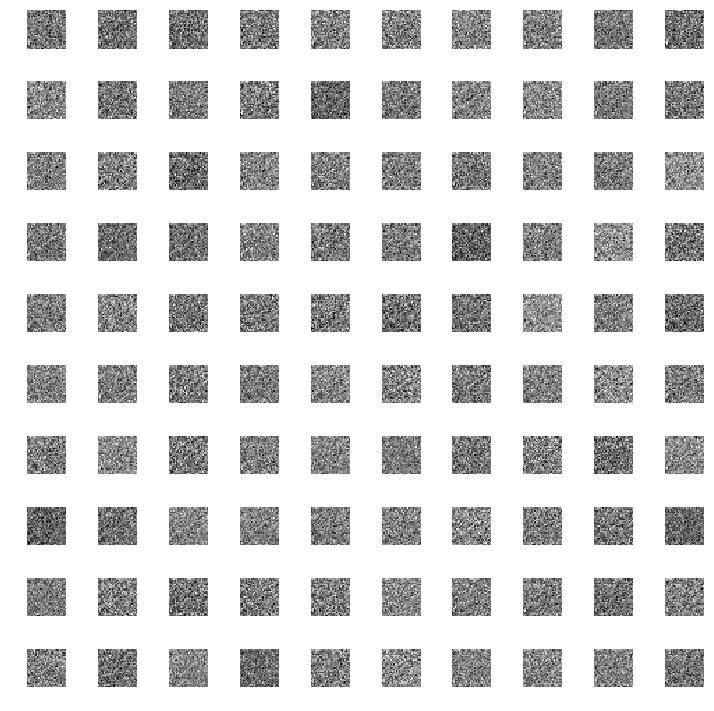

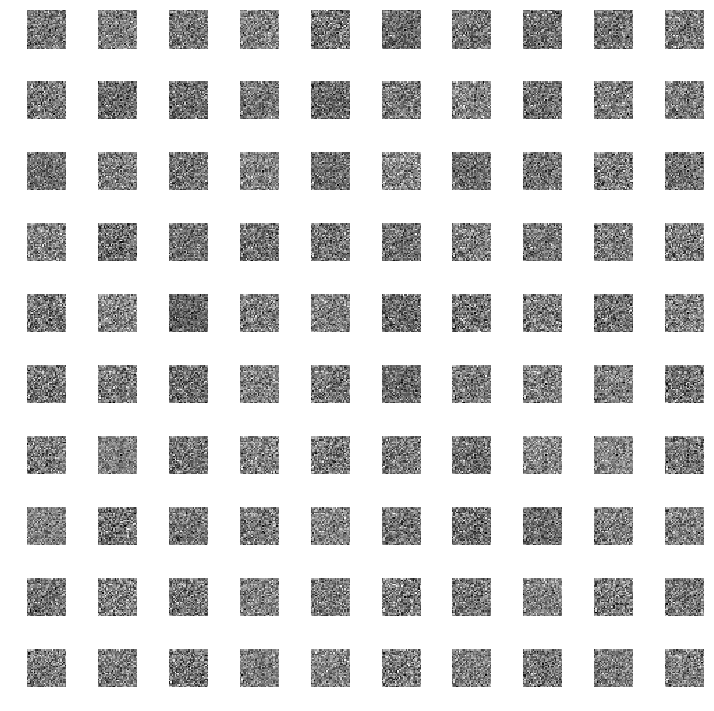

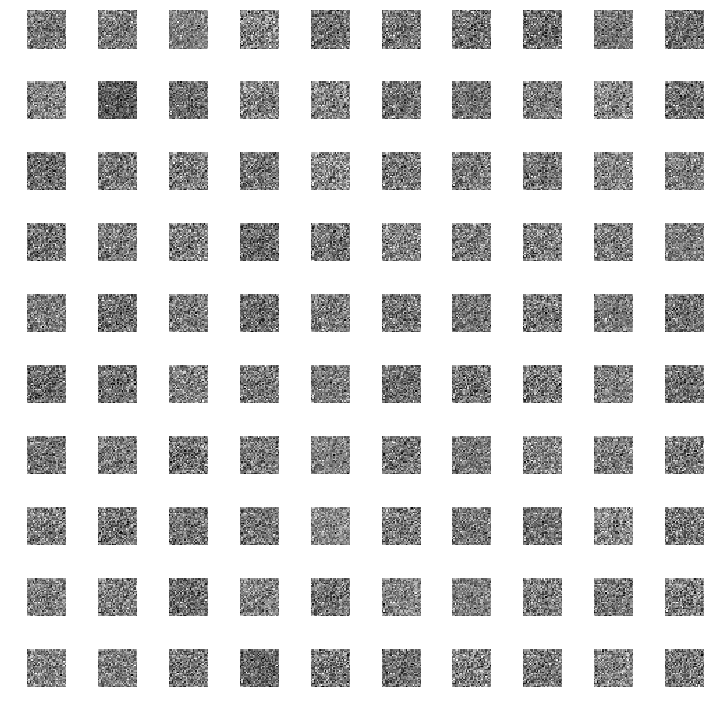

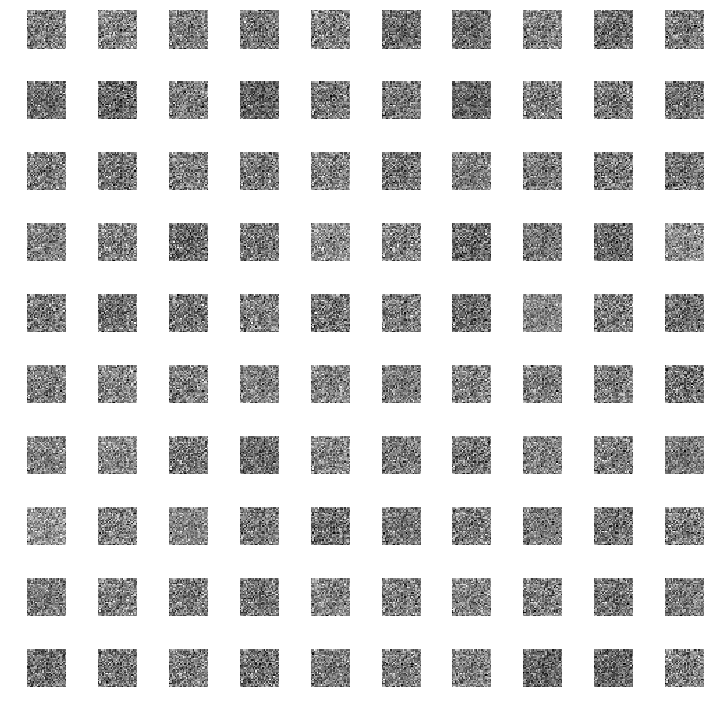

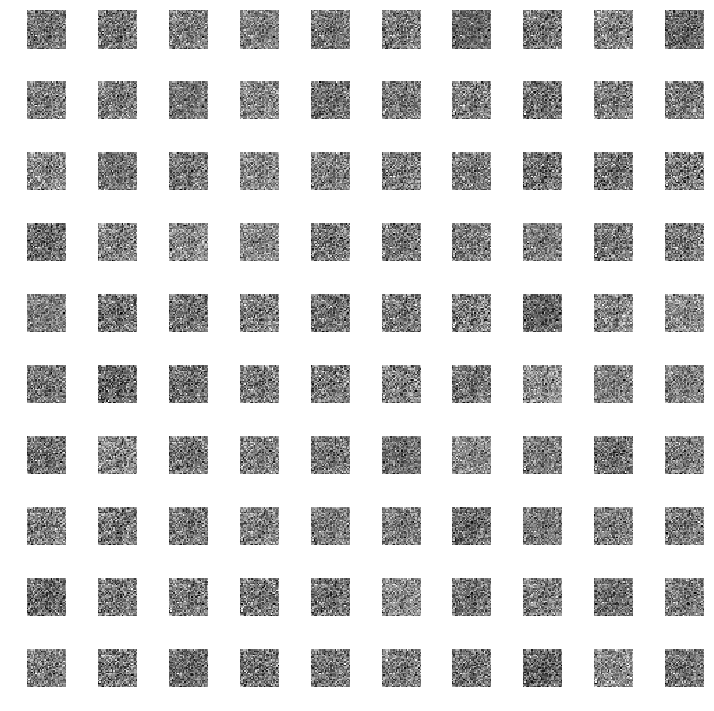

...

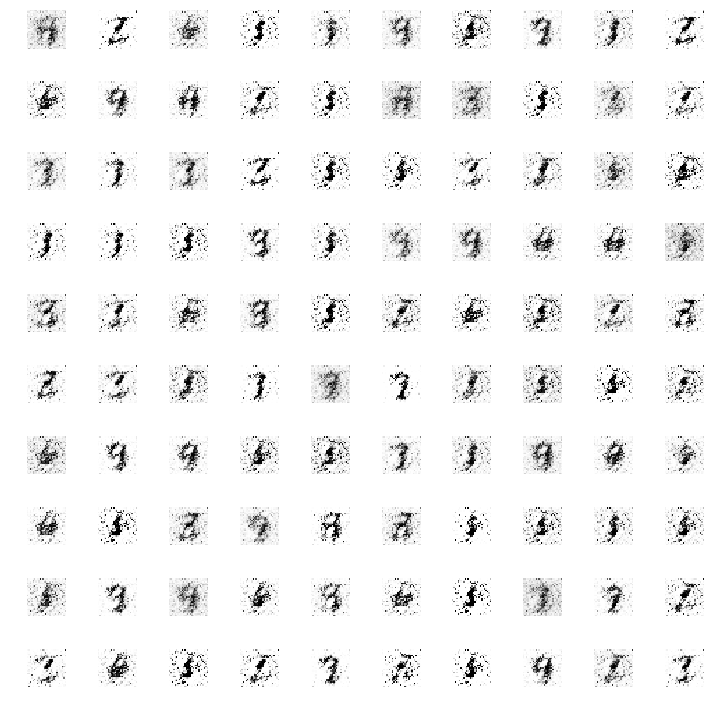

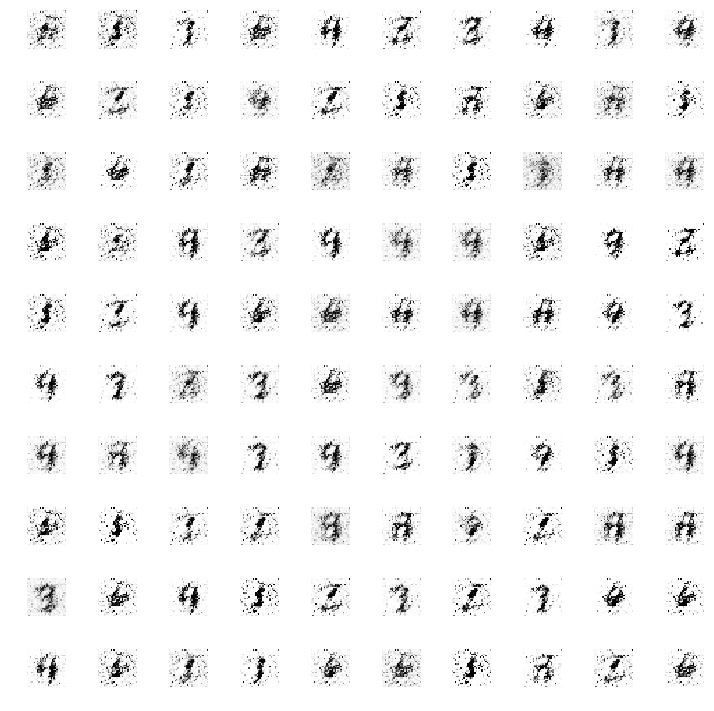

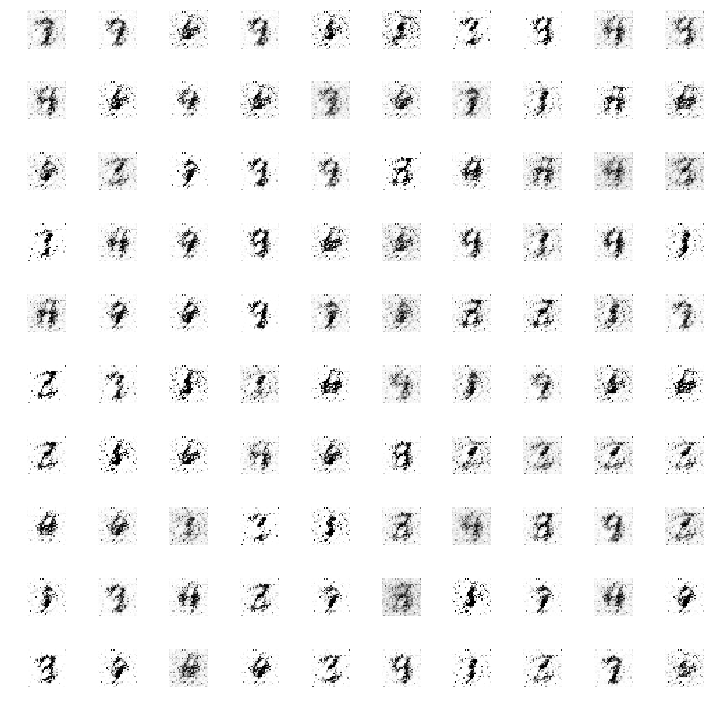

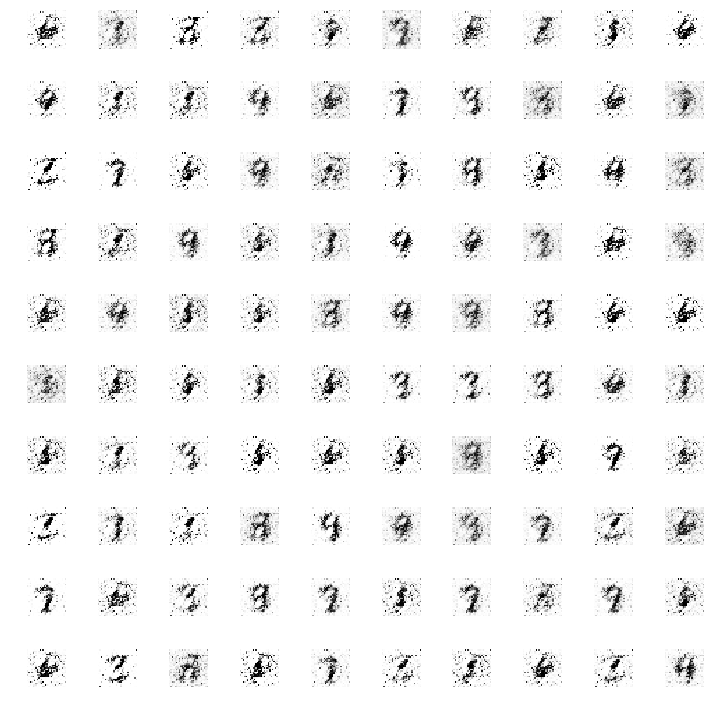

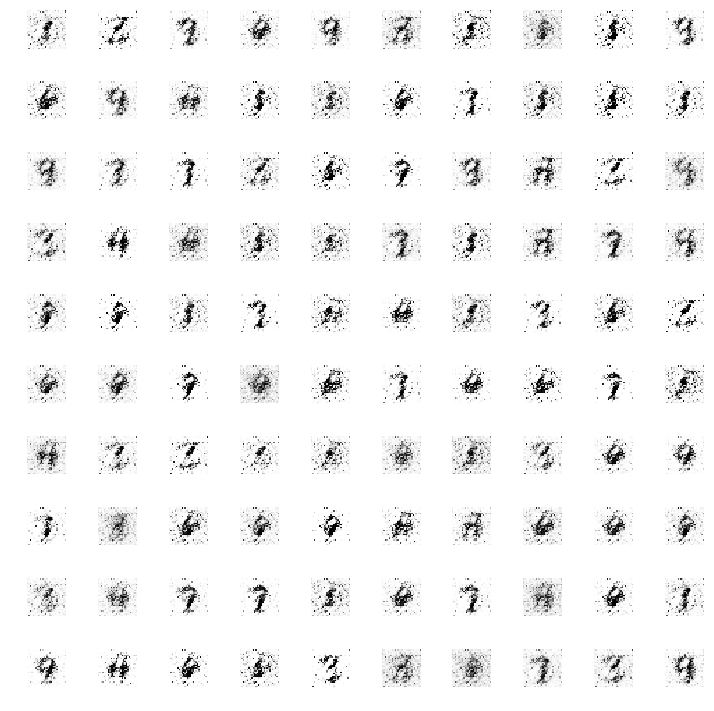

In [18]:
train(20, 20)